### 2022 BUSINESS DATA - Data Cleaning and Assumptions

Two possible ways to experiment filtering the data: 

- Choose which SIC/NAICS code we would use to filter out the data 
- String match the companies to their Parent companies (Big 4) and then utilize the corresponding SIC code for filtering 


*The students used the 2022 Business Data which was filtered to grocery stores only by Todd* - **Rahim**

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)

import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd

from shapely.geometry import Point
import fiona
import math
import plotly.express as px
import random

from thefuzz import fuzz
from thefuzz import process

In [2]:
local_path = "../../rafi_data/2022_Business_Academic_QCQ_grocery.csv"
# Data hosted on box: https://uchicago.box.com/s/yepla37ch7s7mismml8ftda0b7nqjk8m
# This data was filtered by Todd to include all grocery stores in 2022

stores_2022 = pd.read_csv(local_path)

# Drop unnecessary column
stores_2022.drop(columns=['Unnamed: 0'], inplace=True)

# Filter out unwanted territories
territories = ['PR', 'FM', 'MP', 'GU', 'VI', 'MH']
stores_2022 = stores_2022[~stores_2022['STATE'].isin(territories)]

# Display first few rows
stores_2022.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE
0,GOMART,55 POSTAL PLZ,MORGANTOWN,WV,26508,7005.0,61.0,304,2,C,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,554110.0,ALTERNATIVE FUELS,NaN,NaN,NaN,NaN,NaN,NaN,2022,21303.0,13.0,2482.0,2,NaN,NaN,NaN,NaN,998372387,NaN,124929449.0,50.0,389500.0,E,I,998372387.0,NaN,7,11000.0,3.0,39.594376,-79.954437,P,34060.0,2.0,390.0,54061.0
1,7-ELEVEN,485 E MAIN ST,EL CENTRO,CA,92243,2619.0,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,W,NaN,NaN,NaN,495660326,NaN,5863311.0,800.0,1272634.0,H,K,495660326.0,NaN,7,11400.0,3.0,32.792679,-115.536058,0,20940.0,2.0,0.0,6025.0
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0
4,CIRCLE K,123 E MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541103,CONVENIENCE STORES,44512001.0,CONVENIENCE STORES,554101.0,SERVICE STATIONS-GASOLINE & OIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,6.0,1273.0,2,F,NaN,NaN,NaN,855113817,NaN,450720289.0,650.0,4981020.0,H,J,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0


### Experimenting with NAICS Codes: 
#### NAICS Codes:

**- 445110 - Supermarkets and Other Grocery (except Convenience) Stores** (Kroger Co and
Albertsons Companies LLC)

**- 455219 - All Other General Merchandise Retailers** (Costco Wholesale Corporation)

**- 452311 - Warehouse Clubs and Supercenters** (Walmart)
    
##### PROBLEM : While the NAICS codes provides a pretty accurate result, a lot of WALMARTs are missing from the NAICS grouping.

### Research Questions


1. To what extent is corporate concentration found today within the United States grocery industry?<br>
2. How does this vary by state or geographic region?<br>
3. How has the monopoly power of groceries’ parent companies changed over time?

**Note**: *The students listed these questions but the analysis below doesn't completely answers this*. - Rahim

In [3]:
# Create lists of Supermarkets/Companies owned by the 
# Parent Coporations of Interest (Supermarkets/Companies were taken from Wikipedia)

# Ahold Delhaize owned supermarkets/companies
ahold_owned = ["Bottom Dollar Food",
    "Food Lion",
    "FreshDirect",
    "Giant",
    "Giant Food",
    "Hannaford",
    "Stop & Shop",
    "Peapod",
    "Bfresh",
    "Eastside Marketplace",]

# WALMART owned supermarkets/companies
walmart_owned = ["WALMART","SAM'S CLUB"]

# Krogers owned supermarkets/companies
kroger_owned = ["Baker's",
    "City Market",
    "Dillons",
    "Food 4 Less",
    "Foods Co.",
    "Fred Meyer",
    "Fry's",
    "Gerbes",
    "Harris Teeter",
    "JayC",
    "King Soopers",
    "Kroger",
    "Mariano's",
    "Metro Market",
    "Pay Less",
    "Pick 'n Save",
    "QFC",
    "Ralphs",
    "Ruler Foods",
    "Smith's",]

# Albertsons owned supermarkets/companies
albertsons_owned = ["Acme Markets",
    "Albertsons",
    "Albertsons Market",
    "Amigos",
    "Andronico's",
    "Balducci's",
    "Carrs",
    "Haggen",
    "Jewel-Osco",
    "Kings Food Markets",
    "Lucky",
    "Market Street",
    "Pak 'n Save",
    "Pavilions",
    "Randalls",
    "Safewa",
    "Shaw's",
    "Star Market",
    "Tom Thumb",
    "United Supermarkets",
    "Vons",
    "Buttrey Food and Drug",
    "Max Food and Drug",
    "Max Foods",
    "Skagg's Albertsons",
    "Super Saver",]

# Costco owned supermarkets/companies
costco_owned = ["Costco"]

In [4]:
# Apply a string match through thefuzz that compares all stores to the parent corporations owned stores
# We decided to use a threshold of 77
# Generates a list of potential unique string matches
# The matches list's length is based on the number of different stores the parent corporation owns
# parent was initialized for each parent coporation

def string_match(parent):
    companies = stores_2022["COMPANY"]

    matches = []
    for item in parent:
        for result in process.extract(item, companies, limit=len(parent)+1):
            store = result[0]
            score = result[1]
            if score >= 77 and store not in matches:
                matches.append(store)

    print(matches)

# i.e. Parent = walmart_owned
# returns: ['WALMART GROCERY PICKUP', 'WALMART GROCERY PKUP-DELIVERY', "SAM'S CLUB DELI"]

In [5]:
# Generated String Matches from the function above

# String matched brands owned by Walmart:
walmart_string = ['WALMART GROCERY PICKUP', 'WALMART GROCERY PKUP-DELIVERY', "SAM'S CLUB DELI"]
# Doesn't appear to have Walmart Neighborhood Stores

# String matched brands owned by Ahold Delhaize:
ahold_string = ['BOTTOM DOLLAR', 'DOLLAR DOLLAR', 'FOOD', 'FOOD 4 LESS', 
                'FOOD LION', 'FRESH DIRECT', 'REC', 'FRESH', 'H & H', 'S & S', 'FRESHII', 
                'GIANT', 'GIANT EAGLE', 'GIANT EAGLE FLORAL', 'GIANT FOOD', 'HANNAFORD', 
                'STOP & SHOP', 'PEA POD', 'BFRESH MARKET', 'REFRESH', 'EASTSIDE MARKETPLACE', 
                'WESTSIDE MARKETPLACE', 'MARKET', 'E MARKET', 'MARKETPLACE']

# String matched brands owned by Kroger:
kroger_string = ["BAKER'S", 'S & S', 'BAKERS', "BAKER'S GAS & WELD SUPLS INC", "BAKER'S GAS", 
                 "BAKER'S MARKET", "BAKER'S PRO FARM LLC", 'BAKER STREET MARKET', "BAKER'S KWIK SHOP", 
                 'CITY MARKET', 'DILLONS', 'FOOD 4 LESS', 'FOODS CO', 'FRED MEYER', "FRY'S FOOD", 
                 'GERBES SUPER MARKET', 'GERBES SUPER MARKETS', 'GE', 'GERBES SUPERMARKET', 'HARRIS TEETER', 
                 'JAYC', "JAYCEE'S", 'JAYCON', 'CITY-RALEIGH-JAYCEE PARK-CMNTY', 'JAYCE MINIMARKET', 
                 'NAY & JAY', 'KING SOOPERS', 'KROGER', "MARIANO'S", 'METRO MARKET', 'METRO MINI MARKET', 
                 'MARKET MARKET', 'PAY LESS LIQUORS', 'PAY LESS SUPER MARKETS', 'PAY LESS GAS & FOOD', 
                 'PAY LESS IGA', 'FOOD FOR LESS', 'FAR LESS FOOD MARKET', 'MORE FOR LESS', 'PRICE LESS FOODS', 
                 'COST LESS FOODS CO', "PICK'N SAVE", 'QFC', 'RALPHS', 'RULER FOODS', "SMITH'S"]

# String matched brands owned by Costco
costco_string = ["COSTCO DELI"]

# String matched brands owned by Albertsons
albertsons_string = ['ACME MARKETS', 'ALBERTSONS', 'ALBERTSONS MARKET', 'MARKET MARKET', 
                     'MARKET', '2 AMIGOS', 'AMIGO', 'LOS AMIGOS DISTRIBUTING', 'DOS AMIGOS MARKET', 
                     '3 AMIGOS BEER WINE-FOOD STORE', 'THREE AMIGOS', 'AMIGOS FOOD MART', 
                     'LOS AMIGOS', 'AMIGOS MKT LOS', 'AMIGOS MARKET 7', 'TIENDA LOS AMIGOS', 
                     'AMIGOS CONVENIENCE STORE', 'LOS AMIGOS UNO', 'AMIGOS LATIN GROCERY', 
                     'AMIGOS UNITED', 'AMIGOS FOOD MART LLC', 'LOS AMIGOS MARKET', 
                     'LOS AMIGOS SUPERMARKET', 'ICO', "ANDRONICO'S COMMUNITY MARKETS", 
                     "KRAUSZER'S FOOD STORE", "CASEY'S", "MR T'S", "SEVEN'S", 
                     "PATTY'S PANTRY & DELI", "CASHION'S QUIK STOP", 'E C F S SNACKS LLC', 
                     "MICKEY'S T-MART INC", "STATLER'S COUNTRY MART", "MIKE'S CONVENIENCE", 
                     "BELL'S ROWLESBURG GROCERY", "SOCCORSI'S GROCERY & SUBS", 'CC', 
                     "BALDUCCI'S FOOD LOVER'S MARKET", "DANIEL'S MARKET", "GRILLO'S MARKET", 
                     'S & G CONVENIENCE MART', "NANCY'S FOODMART", "MILLER'S MARKETS", 
                     "MAYNARD'S OF FLANDREAU", "SKIP'S", "HARDESTY'S EXPRESS MART LLC", 
                     "KASSAR'S FOOD & GIFTS", "JERRY'S MARKET & LIQUOR", "SHELLY'S GROCERY & BAKERY LLC", 
                     'CARRS/SAFEWAY', 'CARRS SAFEWAY', 'CARRS QUALITY CTR PALMER SHPG', 
                     'BIG CHEAP CASH & CARR', 'C & B USED CARS', 'HAGGEN', 'HAGGEN FOOD & PHARMACY', 
                     'HAGGEN SUPPORT CTR', 'HAGGEN FOOD', 'GE', 'JEWEL-OSCO', 'KINGS FOOD MARKETS', 
                     'KINGS FOOD MARKET', "KING'S FOOD MARKET", "KING'S FOODMARKET", 'KINGS FOOD MART', 
                     'FOOD', 'LUCKY', 'LUCKY 3', 'LUCKY 7', "LUCKY'S", 'LUCKY 8', 'LUCKYS', 
                     'LUCKY SEVEN FOOD STORE', 'LUCKY FOOD FARMERS MARKET', 'LUCKY GROCERY & DELI', 
                     'LUCKY DOLLAR', 'LUCKY CHARM CONVENIENCE STORE', 'LUCKY STAR MARKET LLC', 
                     'LUCKY FOOD MART LLC', 'LUCKY MARKET', "LUCKY'S STATION", 'LUCKY MARKET LLC', 
                     "LUCKY'S SUPER MARKET", 'MARKET STREET', "PAK 'N SAVE", 'U-SAVE FOOD STORE', 
                     'GOLD LINE GRAB N GO', 'INDO PAK SUPERMARKET', 'STOP N GO FOOD MART', 
                     'STOP N GO ENTERPRISES INC', "OCALA SHOP N' PLAY LLC", 'J & N MINI MART 2', 
                     "GRAB 'N GO MART LLC", 'KWIK PAK FOOD MART', "SHOP 'N SAVE EXPRESS", 
                     'PIC-N-SAVE MARKET', 'U-SAVE TRAVEL PLAZA', "UP NORT' SWEET N SAVORY", 
                     'STOP N SHOP WESTFIELD', "SACK 'N SAVE FOOD", "STOP 'N GO MARKETS OF TEXAS", 
                     'CARTA N SHORE GARAGE', 'MASALA INDO PAK GROCERS', 'IN N OUT FOOD & GAS LLC', 
                     "GAS 'N' GO FOOD & BEVERAGE", 'N A M C COMMUNITY MARKET INC', 'PAVILIONS', 
                     'RANDALLS', 'SAFEWAY', 'S & S', "SHAW'S SUPERMARKET", "SHAW'S SUPERMARKETS INC", 
                     'STAR MARKET', 'TOM THUMB', 'UNITED SUPERMARKETS', 'VONS', 'FOOD 4 LESS', 
                     'FOOD MART', 'FOOD LION', 'HERA FOOD MART', 'FOOD TOWN', 'FOOD FAIR', 
                     'OHM FOOD MART', "D'S FOOD STORE", 'FOOD EXPRESS', 'E Z FOOD MART', 
                     'JR FOOD MART', 'EXPRESS FOOD', 'MR FOOD MART', 'CITGO CONVENIENT FOOD MART', 
                     'GREEN ACRES HEALTH FOOD STORE', 'FRIENDSHIP FOOD STORES INC', 
                     'VERISTAS AFRICAN FOOD STORE', 'ILLINOIS VALLEY FOOD & DELI', "FRY'S FOOD", 
                     'FOOD CITY', 'MAX FOODS', 'MAXI FOODS', 'FOODS', 'FOOD MAX', 'SUPER ONE FOODS', 
                     'SUNSHINE FOODS', 'JAMBOREE FOODS', 'DAY STAR FOODS', "SULLIVAN'S FOODS", 
                     'AFFILIATED FOODS CO-OP', "JENSEN'S FINEST FOODS", 'EAST DAKOTAH NATURAL FOODS', 
                     "JENSEN'S FOODS", 'RITE PRICE FOODS', 'VALLEY CENTER FOODS', 'SUPER SAVER', 
                     'SUPER SAVE', 'SUPER SAVER INC', 'SUPER', 'SUPER SAVER COST PLUS', "SAAR'S SUPER SAVER FOODS"]

In [6]:
# Cleaned lists from the string matches of supermarkets/companies actually owned by the parent coprporation
# NOTE: There will be a margin of error from this process because stores were validated through manual checks
# NOTE: It was unrealistic to manually inspect every store generated this way so there will be 
# supermarkets/companies that do not actually belong to the parent coporation
# NOTE: STOP AND SHOP SUPERMARKET was missing from string match so it was manually added

#KROGERS FINAL
kroger_clean = ["BAKER'S",
 'BAKERS', 
 'CITY MARKET',
 'DILLONS',
 'FOOD 4 LESS', 
 'FOODS CO', 
 'FRED MEYER', 
 "FRY'S FOOD",
 'GERBES SUPER MARKET',  
 'GERBES SUPER MARKETS', 
 'GERBES SUPERMARKET', 
 'HARRIS TEETER', 
 'JAYC', 
 'KING SOOPERS',
 'KROGER',
 "MARIANO'S",
 'METRO MARKET', 
 'PAY LESS SUPER MARKETS',
 "PICK'N SAVE", 
 'QFC', 
 'RALPHS', 
 'RULER FOODS', 
 "SMITH'S"]

#Ahold Delhaize FINAL:
ahold_clean = ['FOOD LION',
 'GIANT',
 'GIANT EAGLE',
 'GIANT FOOD',
 'HANNAFORD',
 'STOP & SHOP',
 'BFRESH MARKET',
 'EASTSIDE MARKETPLACE','STOP & SHOP SUPERMARKET']

#WALMART FINAL:
walmart_clean = ['WALMART GROCERY PICKUP',
 'WALMART GROCERY PKUP-DELIVERY', 
 "SAM'S CLUB DELI"]

#COSTCO FINAL:
costco_clean = ["COSTCO DELI"]

#ALBERTSONS FINAL:
albertsons_clean = ['ACME MARKETS',
'ALBERTSONS',
'ALBERTSONS MARKET',
'AMIGOS UNITED',
"ANDRONICO'S COMMUNITY MARKETS",
'CARRS/SAFEWAY',
'CARRS SAFEWAY',
'HAGGEN',
'HAGGEN FOOD & PHARMACY',
'HAGGEN FOOD',
'JEWEL-OSCO',
'KINGS FOOD MARKETS',
'KINGS FOOD MARKET',
'MARKET STREET',
"PAK 'N SAVE",
'PAVILIONS',
'RANDALLS',
'SAFEWAY',
'STAR MARKET',
'TOM THUMB',
'UNITED SUPERMARKETS',
'VONS',
'SUPER SAVER',
'CARRS QUALITY CTR PALMER SHPG',
 "SAAR'S SUPER SAVER FOODS"]

In [7]:
# Records the removed values from the string matching for each store
# "Removed" list can be used to see the values we chose to remove from the string match

kroger_removed = [value for value in kroger_string if value not in kroger_clean]
ahold_removed = [value for value in ahold_string if value not in ahold_clean]
walmart_removed = [value for value in walmart_string if value not in walmart_clean]
costco_removed = [value for value in costco_string if value not in costco_clean]
albertsons_removed = [value for value in albertsons_string if value not in albertsons_string]

In [8]:
def parent_name(row):
    '''Creates a new column called "PARENT NAME" based on the cleaned string match list''' 
    '''The new column generalizes individual companies into their parent coporation (ie. Walmart, Krogers, etc.)''' 
    companies = row['COMPANY']  
    
    if companies in walmart_clean:
        return 'WALMART'
    if companies in costco_clean:
        return 'COSTCO'
    if companies in ahold_clean:
        return 'AHOLD DELHAIZE'
    if companies in kroger_clean:
        return 'KROGER'
    if companies in albertsons_clean:
        return 'ALBERTSONS'
    else:
        return 'OTHER'

In [9]:
# Add parent name using the function above
stores_2022['PARENT NAME'] = stores_2022.apply(parent_name, axis=1)

In [10]:
# Locate the unique primary sic codes present within the supermarkets/companies owned by the 
# parent corporations of interest
# These unique primary SIC codes will be used as the basis of how we filter the main dataset 
# to include only relevant supermarkets/companies (ie. removing convenient stores)

# Step 1: Filter a dataframe based on parent coporations
parent_companies = ['WALMART', 'COSTCO', 'KROGER', 'AHOLD DELHAIZE','ALBERTSONS']
filtered_df = stores_2022[stores_2022['PARENT NAME'].isin(parent_companies)]

# Step 2: Extract the PRIMARY SIC CODES values
primary_sic_codes = filtered_df['PRIMARY SIC CODE']

# Step 3: Get the unique PRIMARY SIC CODES values
unique_sic_codes = primary_sic_codes.unique()

# Print the unique PRIMARY SIC CODES
unique_sic_codes = np.delete(unique_sic_codes,(np.where(unique_sic_codes == 541103)))

# NOTE: remove SIC Code 541103 since it contains the SIC code for convenient stores


In [11]:
def sic_filter(df):
    """
    Filters the dataframe to keep only the stores with specific primary SIC codes,
    including NaN values. SIC codes are from the parent corporation's subsidiary's Primary SIC codes

    The function takes in an unfiltered dataframe as a parameter.
    The function returns a filtered dataframe.
    """
    sic_codes = unique_sic_codes
    filtered_df = df[df['PRIMARY SIC CODE'].isin(sic_codes) | df['PRIMARY SIC CODE'].isna()]
    return filtered_df

In [12]:
# only filtering appropriate SIC codes
supermarkets_2022 = sic_filter(stores_2022)

In [13]:
def update_parent_name(df):
    """
    Helps account for erros in manual string matching selection
    Checked for different Parent Numbers within each Parent Group and if the company had a different Parent Number 
    than the accepted, the company was grouped to other
    """
    accepted_parent_numbers = {
        238136725.0: "AHOLD DELHAIZE",
        5995907.0: "ALBERTSONS",
        7521503.0: "KROGER",
        5889993.0: "WALMART",
        441311800.0: "COSTCO"
    }
    
    for parent_number, parent_name in accepted_parent_numbers.items():
        df.loc[(df["PARENT NUMBER"] != parent_number) & (df["PARENT NAME"] == parent_name), "PARENT NAME"] = "OTHER"
    
    return df

In [14]:
# mapping parent numbers to names using the function above
supermarkets_2022 = update_parent_name(supermarkets_2022)

#Assigns Parent Number of Albertsons to CARRS
supermarkets_2022.loc[supermarkets_2022[supermarkets_2022["COMPANY"] == \
                                        "CARRS QUALITY CTR PALMER SHPG"].index, "PARENT NUMBER"] = 5995907.0

#### Getting some metadata below

In [15]:
supermarkets_2022.shape
# There are 78449 supermarkets/related companies in the entire US

(78449, 54)

In [16]:
# Finds the Store Count for Each Major Parent Company and Other
store_count_us = supermarkets_2022.groupby('PARENT NAME')\
                .count()[["CITY"]].reset_index().rename(columns={"CITY":"STORE COUNT"})
store_count_us.head()

,PARENT NAME,STORE COUNT
0,AHOLD DELHAIZE,1713
1,ALBERTSONS,2191
2,COSTCO,29
3,KROGER,2716
4,OTHER,68098


# Analyzing Store Count for Specific Areas

In [17]:
# NorthEast 
# New York 

supermarkets_2022_ny = supermarkets_2022.loc[supermarkets_2022["STATE"] == "NY"]
supermarkets_2022_ny.head() 

# There are Supermarkets/companies in NY

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,PARENT NAME
785,WHOLE FOODS MARKET,450 W 33RD ST,NEW YORK,NY,10001,2603.0,61.0,646,2,A,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,4.0,27500.0,2,Q,2020.0,NaN,NaN,750467095,448111633.0,886012012.0,200.0,469822000.0,F,K,750467095.0,NaN,7,10300.0,1.0,40.753047,-73.999445,P,35620.0,2.0,408.0,36061.0,OTHER
1754,GRISTEDES-SLOANS SPRMKTS,1544 YORK AVE,NEW YORK,NY,10028,NaN,61.0,212,2,A,B,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,4.0,734.0,9,NaN,2020.0,NaN,NaN,753141325,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,13800.0,6.0,40.775900,-73.952500,X,35620.0,2.0,408.0,36061.0,OTHER
2153,453 HARLEM,453 W 125TH ST # GRND,NEW YORK,NY,10027,4200.0,61.0,917,2,NaN,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,581208.0,RESTAURANTS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,NaN,83.0,9,NaN,2020.0,NaN,NaN,753792963,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,8,20901.0,1.0,40.812935,-73.955461,P,35620.0,2.0,408.0,36061.0,OTHER
2362,MUNCHIES TO GO LLC,110 W 40TH ST # 2302,NEW YORK,NY,10018,3623.0,61.0,212,2,A,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,4.0,1467.0,9,NaN,2021.0,NaN,NaN,759353943,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,5,11300.0,1.0,40.753681,-73.985922,P,35620.0,2.0,408.0,36061.0,OTHER
2892,SLOANS GRISTEDES SPRMKTS,1446 2 AVENUE AT 75,NEW YORK,NY,10001,NaN,61.0,212,2,D,E,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,30.0,5500.0,9,NaN,2020.0,NaN,NaN,753141061,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,9500.0,2.0,40.748300,-73.992900,X,35620.0,2.0,408.0,36061.0,OTHER


In [18]:
# Finds the Percent of Brick and Mortar and Store Count for Each Major Parent Company and Other in NY

store_count_ny = supermarkets_2022_ny.groupby('PARENT NAME')\
                .count()[["CITY"]].reset_index().rename(columns={"CITY":"STORE COUNT"})
store_count_ny['Percent'] = store_count_ny['STORE COUNT'] / supermarkets_2022_ny.shape[0] * 100

store_count_ny

# External Sources
# AHOLD DELHAIZE: 52 Hannaford ( troyrecord.com ), 100 Stop and shop (stop and shop.com) 
# ALBERTSONS: 19 stores ( statista.com )
# KROGER: 0
# WALMART: 119 stores ( statista.com )
# COSTCO:19 stores ( costco.com )

,PARENT NAME,STORE COUNT,Percent
0,AHOLD DELHAIZE,123,1.942207
1,ALBERTSONS,18,0.284225
2,COSTCO,4,0.063161
3,OTHER,6114,96.541923
4,WALMART,74,1.168483


## DATA VISUALIZATIONS

In [19]:
# Mapping all grocery stores across the US 

import plotly.express as px 

fig = px.scatter_mapbox(supermarkets_2022, lat="LATITUDE", lon="LONGITUDE", hover_data=["COMPANY"], 
                        color="PARENT NAME",zoom=2,
                        color_discrete_sequence=["blue", "green", "red","yellow","orange","purple"], 
                        mapbox_style="open-street-map")

fig.show()

In [20]:
# density map of sales by location 

import plotly.express as px
fig = px.density_mapbox(supermarkets_2022, lat='LATITUDE', lon='LONGITUDE', 
                        z='SALES VOLUME (9) - LOCATION', radius=10,
                        center=dict(lat=46, lon=-88), zoom=2,
                        mapbox_style="stamen-terrain")
fig.show()

### Additional Visual Analysis

In [21]:
# bar graph: sum of sales volume per location 
x_column = "PARENT NAME"
y_column = "SALES VOLUME (9) - LOCATION"

grouped_df = supermarkets_2022.groupby(x_column)[y_column].sum().reset_index()

fig = px.bar(grouped_df, x=x_column, y=y_column, title="Total Sales Volume by Parent Name")

fig.show()

In [22]:
# bar graph: sum of parent actual sales volume (Data from a different column)

x_column = "PARENT NAME"
y_column = "PARENT ACTUAL SALES VOLUME"

grouped_df = supermarkets_2022.groupby(x_column)[y_column].sum().reset_index()

fig = px.bar(grouped_df, x=x_column, y=y_column, title="Total Actual Sales Volume by Parent Name")

fig.show()

In [23]:
# bar graph: sum of parent actual employee size

x_column = "PARENT NAME"
y_column = "PARENT ACTUAL EMPLOYEE SIZE"

grouped_df = supermarkets_2022.groupby(x_column)[y_column].sum().reset_index()

fig = px.bar(grouped_df, x=x_column, y=y_column, title="Total Actual Employee Size by Parent Name")

fig.show()

In [24]:
# bar graph: sum of parent actual employee size per location


x_column = "PARENT NAME"
y_column = "EMPLOYEE SIZE (5) - LOCATION"

grouped_df = supermarkets_2022.groupby(x_column)[y_column].sum().reset_index()

fig = px.bar(grouped_df, x=x_column, y=y_column, title="Total Employee Size per location by Parent Name")

fig.show()

In [25]:
# Assume you have a DataFrame or Series named new_column_data with values to be added
parentcomp_column = pd.Series(['219.18 ', '148.3 ','222.7 ','91.64', '77.65'], 
                              name="Total Company Sales 2022(In Billions)")

# Create a dictionary mapping parent names to corresponding new column values
mapping_dict = {"WALMART": 219.18, "KROGER": 148.3,"COSTCO": 222.7, "AHOLD": 91.64, 'ALBERTSONS': 77}

# Add the new column based on the mapping
supermarkets_2022["Total Company Sales 2022(In Billions)"] = supermarkets_2022["PARENT NAME"].map(mapping_dict)

# Display the updated supermarkets_2022 DataFrame
supermarkets_2022.head()

/var/folders/zm/8rv6kmlx43s272rwjp4vlnt80000gn/T/ipykernel_7805/3472281584.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,PARENT NAME,Total Company Sales 2022(In Billions)
2,EL SOL MARKET,110 W MAIN ST,WESTMORLAND,CA,92281,NaN,25.0,760,2,B,C,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,5.0,1061.0,9,NaN,NaN,NaN,NaN,519605455,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3,10200.0,1.0,33.051800,-115.581800,X,20940.0,2.0,0.0,6025.0,OTHER,NaN
3,COOL SPRINGS GROCERY,241 WILDWOOD ST,MORGANTOWN,WV,26505,3141.0,61.0,304,2,A,A,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,2.0,382.0,9,NaN,NaN,NaN,NaN,817953730,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,10400.0,4.0,39.652885,-79.986398,P,34060.0,2.0,390.0,54061.0,OTHER,NaN
5,EL SOL MEAT MARKET,1100 MEADOWS RD # B,CALEXICO,CA,92231,5917.0,25.0,760,2,D,E,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,542107.0,MEAT-RETAIL,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,29.0,6153.0,9,NaN,NaN,NaN,NaN,995912391,NaN,NaN,NaN,NaN,NaN,NaN,995912391.0,NaN,7,12002.0,2.0,32.679923,-115.482166,P,20940.0,2.0,0.0,6025.0,OTHER,NaN
7,KROGER,1600 S OHIO ST,MARTINSVILLE,IN,46151,3317.0,109.0,765,2,F,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,102.0,21931.0,2,P,NaN,NaN,NaN,140765967,NaN,7521503.0,1200.0,137888000.0,I,I,140765967.0,NaN,7,510701.0,2.0,39.411880,-86.425148,P,26900.0,2.0,294.0,18109.0,KROGER,148.3
8,FOOD 4 LESS,2420 COTTONWOOD DR,EL CENTRO,CA,92243,1604.0,25.0,760,2,E,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,70.0,14851.0,2,ï¿½,NaN,NaN,NaN,215261702,402627138.0,7521503.0,1200.0,137888000.0,I,I,215261702.0,NaN,7,11201.0,1.0,32.815719,-115.572166,P,20940.0,2.0,0.0,6025.0,KROGER,148.3


<function matplotlib.pyplot.show(close=None, block=None)>

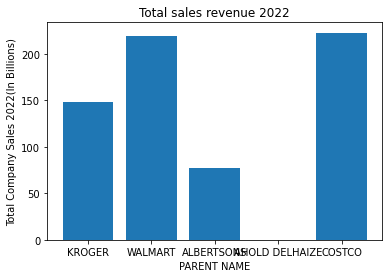

In [26]:
x = supermarkets_2022['PARENT NAME']
y = supermarkets_2022['Total Company Sales 2022(In Billions)']

plt.bar(x, y)
plt.xlabel('PARENT NAME')
plt.ylabel('Total Company Sales 2022(In Billions)')
plt.title ( 'Total sales revenue 2022')
plt.show

In [27]:
def true_sales(row):
    '''Creates a new column called "PARENT NAME" based on the cleaned string match list''' 
    '''The new column generalizes individual companies into their parent coporation (ie. Walmart, Krogers, etc.)''' 
    companies = row['PARENT NAME']  
    
    if companies == "WALMART":
        return 218.944
    if companies == "COSTCO":
        return 85.6
    if companies == "ALBERTSONS":
        return 77.6497
    if companies == "KROGER":
        return 148.3
    if companies == "AHOLD DELHAIZE":
        return .060464538
    if companies == "OTHER":
        return 641.535248

In [28]:
# Mapping the sales value to parent organization
supermarkets_2022['PARENT TRUE SALES (BILLIONS)'] = supermarkets_2022.apply(true_sales, axis=1)

/var/folders/zm/8rv6kmlx43s272rwjp4vlnt80000gn/T/ipykernel_7805/1624368745.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



<function matplotlib.pyplot.show(close=None, block=None)>

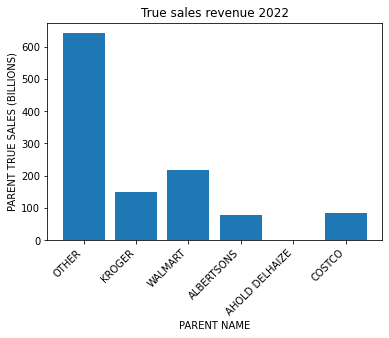

In [29]:
x = supermarkets_2022['PARENT NAME']
y = supermarkets_2022['PARENT TRUE SALES (BILLIONS)']

plt.bar(x, y)
plt.xlabel('PARENT NAME')
plt.ylabel('PARENT TRUE SALES (BILLIONS)')
plt.title ( 'True sales revenue 2022')
plt.xticks(rotation = 45, ha='right')
plt.show

#### Borrowed the work below from other notebooks students created. Combined them for to avoid repeatation - Rahim

In [30]:
def process_dataframe(df):
    """
    Process the dataframe by generating parent numbers for companies.
    Generates a random parent number from 0-9999 if the original parent number was NaN.
    If the same company appears with a parent number of NaN, it doesn't get a new parent number; 
    it gets the same parent number as its counterpart.
    LIMITATIONS: This function does not account for when two different corporations have 
    companies with the same name; it will ultimately group companies with the same name into 
    one parent number even if they are actually different organizations.
    This type of anomaly is infrequent, so we will overlook this issue.
    """

    companies = {}

    def process_row(row):
        company = row["COMPANY"]
        parent_number = row["PARENT NUMBER"]

        if pd.isna(parent_number):
            if company in companies:
                existing_parent = companies[company]
                if not pd.isna(existing_parent):
                    row["PARENT NUMBER"] = existing_parent
            else:
                new_parent_number = random.randrange(0, 9999)
                companies[company] = new_parent_number
                row["PARENT NUMBER"] = new_parent_number
        else:
            companies[company] = parent_number

        return row

    df_na = df.loc[df["PARENT NUMBER"].isna()] 
    company_list = df_na["COMPANY"].unique().tolist()
    df = df.apply(process_row, axis=1)

    return df

In [31]:
# Apply the function above to the dataframe
supermarkets = process_dataframe(supermarkets_2022).copy(deep = True)

In [32]:
supermarkets.loc[supermarkets["SALES VOLUME (9) - LOCATION"].isna()].shape

(1420, 56)

In [33]:
# Fill NaN values for 'SALES VOLUME (9) - LOCATION'
# Locate Companies without a designated parent number (indicated by a parent number of < 9999)
# Split these companies arbitrarily to account for true independent stores and non-independent stores 
# (if there are only 3 companies under the parent number it is classified as independent other)

non_parent_group = supermarkets[supermarkets["PARENT NUMBER"] < 9999]\
                .groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()
independent_non_parent = non_parent_group[non_parent_group["SALES VOLUME (9) - LOCATION"] < 4]
non_par = non_parent_group[non_parent_group["SALES VOLUME (9) - LOCATION"] > 3]

non_parent = supermarkets[supermarkets["FIPS CODE"].isin(non_par["FIPS CODE"])]
np_independent = supermarkets[supermarkets["FIPS CODE"].isin(independent_non_parent["FIPS CODE"])]

In [34]:
# Calculate FIPS CODE-specific medians
median_np = non_parent.groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()
median_np_ind = np_independent.groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()

# Locate Companies with a designated parent number (indicated by a parent number of > 9999)
# Split these companies arbitrarily to account for true independent stores and non-independent stores (if there are only 3 companies under the parent number it is classified as independent other)

parent_group = supermarkets[supermarkets["PARENT NUMBER"] > 9999].groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()
independent_parent = parent_group[parent_group["SALES VOLUME (9) - LOCATION"] < 4]
p = parent_group[parent_group["SALES VOLUME (9) - LOCATION"] > 3]

parent = supermarkets[supermarkets["FIPS CODE"].isin(parent_group["FIPS CODE"])]
independent_parent = supermarkets[supermarkets["FIPS CODE"].isin(independent_parent["FIPS CODE"])]

In [35]:
# Calculate FIPS CODE-specific medians
median_np = non_parent.groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()
median_np_ind = np_independent.groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()
median_parent = parent.groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()
median_parent_ind = independent_parent.groupby("FIPS CODE")["SALES VOLUME (9) - LOCATION"].median().reset_index()

In [36]:
# Update missing values based on FIPS CODE-specific medians
supermarkets = supermarkets.merge(median_np, on="FIPS CODE", suffixes=("", "_median_np"), how="left")
supermarkets.loc[supermarkets["SALES VOLUME (9) - LOCATION"].isnull(), "SALES VOLUME (9) - LOCATION"] = supermarkets["SALES VOLUME (9) - LOCATION_median_np"]

supermarkets = supermarkets.merge(median_np_ind, on="FIPS CODE", suffixes=("", "_median_np_ind"), how="left")
supermarkets.loc[supermarkets["SALES VOLUME (9) - LOCATION"].isnull(), "SALES VOLUME (9) - LOCATION"] = supermarkets["SALES VOLUME (9) - LOCATION_median_np_ind"]

supermarkets = supermarkets.merge(median_parent, on="FIPS CODE", suffixes=("", "_median_parent"), how="left")
supermarkets.loc[supermarkets["SALES VOLUME (9) - LOCATION"].isnull(), "SALES VOLUME (9) - LOCATION"] = supermarkets["SALES VOLUME (9) - LOCATION_median_parent"]

supermarkets = supermarkets.merge(median_parent_ind, on="FIPS CODE", suffixes=("", "_median_parent_ind"), how="left")
supermarkets.loc[supermarkets["SALES VOLUME (9) - LOCATION"].isnull(), "SALES VOLUME (9) - LOCATION"] = supermarkets["SALES VOLUME (9) - LOCATION_median_parent_ind"]

# Drop redundant columns
supermarkets.drop(["SALES VOLUME (9) - LOCATION_median_np", "SALES VOLUME (9) - LOCATION_median_np_ind", "SALES VOLUME (9) - LOCATION_median_parent", "SALES VOLUME (9) - LOCATION_median_parent_ind"], axis=1, inplace=True)

In [37]:
supermarkets.loc[supermarkets["SALES VOLUME (9) - LOCATION"].isna()]

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,PARENT NAME,Total Company Sales 2022(In Billions),PARENT TRUE SALES (BILLIONS)
36855,OAK STREET MARKET,300 OAK ST,WAKEFIELD,NE,68784,5225.0,51.0,402,2,A,NaN,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,4.0,NaN,9,NaN,2022.0,NaN,NaN,765155855,NaN,9764.0,NaN,NaN,NaN,NaN,NaN,NaN,3,977800.0,4.0,42.268865,-96.862423,P,43580.0,2.0,0.0,31051.0,OTHER,NaN,641.535248
74290,KROGER PICK UP,120 PINHOOK RD,MT OLIVET,KY,41064,NaN,201.0,859,2,NaN,NaN,541110,GROCERY PICKUP-CURBSIDE,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,NaN,NaN,NaN,2,NaN,NaN,NaN,NaN,778830535,NaN,7521503.0,1200.0,137888000.0,I,I,NaN,NaN,3,970100.0,1.0,38.523000,-84.068600,X,0.0,NaN,0.0,21201.0,OTHER,NaN,641.535248


In [38]:
#Finds the Percent of Brick and Mortar and Store Count for Each Major Parent Company and Other
store_count_us = supermarkets.groupby('PARENT NAME').count()[["CITY"]].reset_index()\
                .rename(columns={"CITY":"STORE COUNT"})

store_count_us['Percent'] = store_count_us['STORE COUNT'] / supermarkets.shape[0] * 100

store_count_us

,PARENT NAME,STORE COUNT,Percent
0,AHOLD DELHAIZE,1713,2.183584
1,ALBERTSONS,2191,2.792897
2,COSTCO,29,0.036967
3,KROGER,2716,3.462122
4,OTHER,68098,86.805440
5,WALMART,3702,4.718989


# Store Locations of the Top grocery stores in the US


In [39]:

#df is the dataframe you would use, latitude is the latitude metric, longitude is the longitude metric, variable is the column you want to colour by,
#timelapse is the duration over which you want to observe your data, maptitle is the title you want for your map.
def scatterMapBox(df,latitude,longitude,variable,timelapse,maptitle):
    fig = px.scatter_mapbox(df, lat=latitude, lon=longitude, color=variable, 
                            color_continuous_scale=["black", "purple", "red" ],
                            animation_frame= timelapse, size_max=30, height = 600, zoom=2,
                            width = 1000, title= maptitle, mapbox_style="open-street-map")
    return fig


figure = scatterMapBox(supermarkets,'LATITUDE','LONGITUDE','PARENT NAME',
                       'ARCHIVE VERSION YEAR','Grocery Store Locations across the US')
figure.show()

## Geographic overlap of the two brands - Alberstons and Kroger

#### BEFORE MERGER

In [40]:
store_kr_alb= supermarkets.loc[(supermarkets['PARENT NAME'] == 'ALBERTSONS') | \
                               (supermarkets['PARENT NAME'] == 'KROGER')]
store_kr_alb.head()

,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,PARENT NAME,Total Company Sales 2022(In Billions),PARENT TRUE SALES (BILLIONS)
3,KROGER,1600 S OHIO ST,MARTINSVILLE,IN,46151,3317.0,109.0,765,2,F,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,102.0,21931.0,2,P,NaN,NaN,NaN,140765967,NaN,7521503.0,1200.0,137888000.0,I,I,140765967.0,NaN,7,510701.0,2.0,39.411880,-86.425148,P,26900.0,2.0,294.0,18109.0,KROGER,148.3,148.3000
4,FOOD 4 LESS,2420 COTTONWOOD DR,EL CENTRO,CA,92243,1604.0,25.0,760,2,E,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,70.0,14851.0,2,ï¿½,NaN,NaN,NaN,215261702,402627138.0,7521503.0,1200.0,137888000.0,I,I,215261702.0,NaN,7,11201.0,1.0,32.815719,-115.572166,P,20940.0,2.0,0.0,6025.0,KROGER,148.3,148.3000
6,KROGER,301 E MCKINLEY RD,OTTAWA,IL,61350,4805.0,99.0,815,2,E,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,70.0,14158.0,2,P,NaN,NaN,NaN,152123287,NaN,7521503.0,1200.0,137888000.0,I,I,152123287.0,NaN,7,963500.0,1.0,41.323858,-88.836271,P,36837.0,1.0,176.0,17099.0,KROGER,148.3,148.3000
46,RALPHS,42150 WASHINGTON ST,BERMUDA DUNES,CA,92203,9611.0,65.0,760,2,E,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,554101.0,SERVICE STATIONS-GASOLINE & OIL,591205.0,PHARMACIES,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,75.0,21417.0,2,J,NaN,NaN,NaN,586520785,404592156.0,7521503.0,1200.0,137888000.0,I,I,586520785.0,NaN,7,45214.0,2.0,33.742146,-116.302483,P,40140.0,2.0,348.0,6065.0,KROGER,148.3,148.3000
54,VONS,78271 HIGHWAY 111,LA QUINTA,CA,92253,2063.0,65.0,760,2,D,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,546102.0,BAKERS-RETAIL,599201.0,FLORISTS-RETAIL,591205.0,PHARMACIES,592102.0,LIQUORS-RETAIL,NaN,NaN,2022,39106.0,48.0,13707.0,2,P,NaN,NaN,NaN,490644465,441478062.0,5995907.0,800.0,NaN,H,NaN,490644465.0,NaN,7,45125.0,1.0,33.715187,-116.298124,P,40140.0,2.0,348.0,6065.0,ALBERTSONS,77.0,77.6497


In [41]:
#scatterplot showing the locations of only Kroger and Albertsons before the merger  
px.scatter_mapbox(store_kr_alb, lat='LATITUDE', lon='LONGITUDE', color='PARENT NAME',
                            color_continuous_scale=["black", "purple", "red"],
                            animation_group= 'PARENT NAME',height = 600, zoom = 3,
                            width = 1000, title= 'Kroger-Albertsons Geographic Overlap: BEFORE MERGER', 
                  mapbox_style="open-street-map")

The map above shows geographic overlap between the two brands in several areas: Seattle, Los Angeles, Denver, Dallas, Chicago, and Washington DC. 

In these cities, previously competing grocery stores will now be owned by the same company assuming that all Albertsons and Kroger grocery stores will remain open after the merger, resulting in the market share of Albertsons-Kroger to increase in these areas with significant overlap. 

The downside is that it would make it more difficult for other grocery stores with smaller market shares in these regions to compete with Albertsons-Kroger.

In [42]:
#newdf with Merged Kroger - Albertsons

store_kr_alb['PARENT NAME MERGED'] = store_kr_alb['PARENT NAME'].replace(['KROGER', 'ALBERTSONS'], 
                                                                       'KROGER-ALBERTSONS')

store_kr_alb.head()

/var/folders/zm/8rv6kmlx43s272rwjp4vlnt80000gn/T/ipykernel_7805/3090809278.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,COMPANY,ADDRESS LINE 1,CITY,STATE,ZIPCODE,ZIP4,COUNTY CODE,AREA CODE,IDCODE,LOCATION EMPLOYEE SIZE CODE,LOCATION SALES VOLUME CODE,PRIMARY SIC CODE,SIC6_DESCRIPTIONS,PRIMARY NAICS CODE,NAICS8 DESCRIPTIONS,SIC CODE,SIC6_DESCRIPTIONS (SIC),SIC CODE 1,SIC6_DESCRIPTIONS (SIC1),SIC CODE 2,SIC6_DESCRIPTIONS(SIC2),SIC CODE 3,SIC6_DESCRIPTIONS(SIC3),SIC CODE 4,SIC6_DESCRIPTIONS(SIC4),ARCHIVE VERSION YEAR,YELLOW PAGE CODE,EMPLOYEE SIZE (5) - LOCATION,SALES VOLUME (9) - LOCATION,BUSINESS STATUS CODE,INDUSTRY SPECIFIC FIRST BYTE,YEAR ESTABLISHED,OFFICE SIZE CODE,COMPANY HOLDING STATUS,ABI,SUBSIDIARY NUMBER,PARENT NUMBER,PARENT ACTUAL EMPLOYEE SIZE,PARENT ACTUAL SALES VOLUME,PARENT EMPLOYEE SIZE CODE,PARENT SALES VOLUME CODE,SITE NUMBER,ADDRESS TYPE INDICATOR,POPULATION CODE,CENSUS TRACT,CENSUS BLOCK,LATITUDE,LONGITUDE,MATCH CODE,CBSA CODE,CBSA LEVEL,CSA CODE,FIPS CODE,PARENT NAME,Total Company Sales 2022(In Billions),PARENT TRUE SALES (BILLIONS),PARENT NAME MERGED
3,KROGER,1600 S OHIO ST,MARTINSVILLE,IN,46151,3317.0,109.0,765,2,F,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,102.0,21931.0,2,P,NaN,NaN,NaN,140765967,NaN,7521503.0,1200.0,137888000.0,I,I,140765967.0,NaN,7,510701.0,2.0,39.411880,-86.425148,P,26900.0,2.0,294.0,18109.0,KROGER,148.3,148.3000,KROGER-ALBERTSONS
4,FOOD 4 LESS,2420 COTTONWOOD DR,EL CENTRO,CA,92243,1604.0,25.0,760,2,E,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,70.0,14851.0,2,ï¿½,NaN,NaN,NaN,215261702,402627138.0,7521503.0,1200.0,137888000.0,I,I,215261702.0,NaN,7,11201.0,1.0,32.815719,-115.572166,P,20940.0,2.0,0.0,6025.0,KROGER,148.3,148.3000,KROGER-ALBERTSONS
6,KROGER,301 E MCKINLEY RD,OTTAWA,IL,61350,4805.0,99.0,815,2,E,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,70.0,14158.0,2,P,NaN,NaN,NaN,152123287,NaN,7521503.0,1200.0,137888000.0,I,I,152123287.0,NaN,7,963500.0,1.0,41.323858,-88.836271,P,36837.0,1.0,176.0,17099.0,KROGER,148.3,148.3000,KROGER-ALBERTSONS
46,RALPHS,42150 WASHINGTON ST,BERMUDA DUNES,CA,92203,9611.0,65.0,760,2,E,G,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,554101.0,SERVICE STATIONS-GASOLINE & OIL,591205.0,PHARMACIES,NaN,NaN,NaN,NaN,NaN,NaN,2022,39106.0,75.0,21417.0,2,J,NaN,NaN,NaN,586520785,404592156.0,7521503.0,1200.0,137888000.0,I,I,586520785.0,NaN,7,45214.0,2.0,33.742146,-116.302483,P,40140.0,2.0,348.0,6065.0,KROGER,148.3,148.3000,KROGER-ALBERTSONS
54,VONS,78271 HIGHWAY 111,LA QUINTA,CA,92253,2063.0,65.0,760,2,D,F,541105,GROCERS-RETAIL,44511003.0,SUPERMARKETS/OTHER GROCERY (EXC CONVENIENCE) STRS,546102.0,BAKERS-RETAIL,599201.0,FLORISTS-RETAIL,591205.0,PHARMACIES,592102.0,LIQUORS-RETAIL,NaN,NaN,2022,39106.0,48.0,13707.0,2,P,NaN,NaN,NaN,490644465,441478062.0,5995907.0,800.0,NaN,H,NaN,490644465.0,NaN,7,45125.0,1.0,33.715187,-116.298124,P,40140.0,2.0,348.0,6065.0,ALBERTSONS,77.0,77.6497,KROGER-ALBERTSONS


In [43]:
#scatterplot showing the locations of only Kroger and Albertsons after the merger  
px.scatter_mapbox(store_kr_alb, lat='LATITUDE', lon='LONGITUDE', color='PARENT NAME MERGED',
                            animation_group= 'PARENT NAME',height = 600, zoom=3,
                            width = 1000, title= 'Kroger-Albertsons: AFTER MERGER', mapbox_style="open-street-map")